In [1]:
from JupyterImport import *


In [2]:
dats = get_dats(range(89, 92+1), progress=True)

N/A% (0 of 4) |                          | Elapsed Time: 0:00:00 ETA:  --:--:--INFO:src.DatObject.Attributes.DatAttribute:Executing: def i_sense(x, mid, theta, amp, lin, const):
    """ fit to sensor current """
    arg = (x - mid) / (2 * theta)
    return -amp/2 * np.tanh(arg) + lin * (x - mid) + const

100% (4 of 4) |##########################| Elapsed Time: 0:00:12 Time:  0:00:12


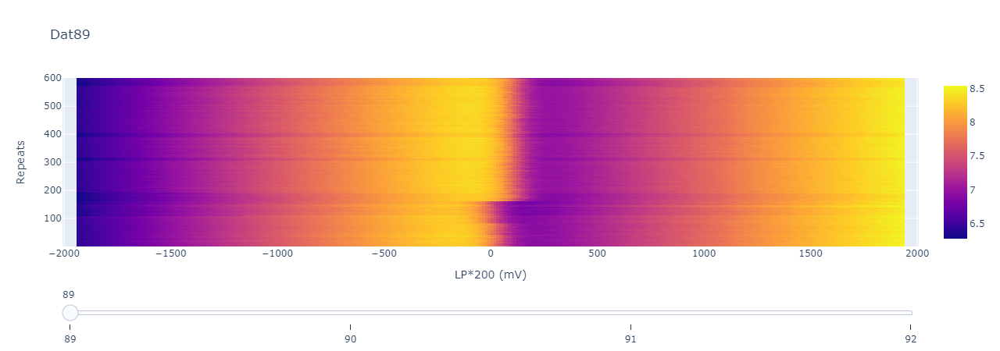

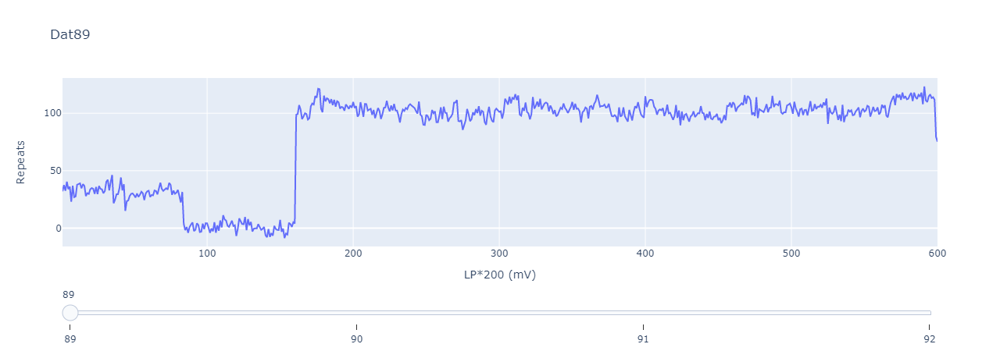

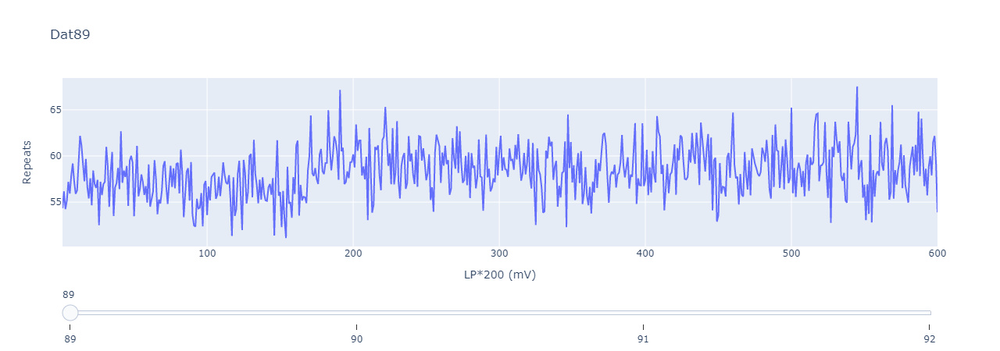

In [3]:
xs, ys, datas, ids, titles, labels, all_mids, all_thetas = list(), list(), list(), list(), list(), list(), list(), list()
for dat in dats:
    data = CU.decimate(dat.Data.i_sense, dat.Logs.Fastdac.measure_freq, 300)
    ox = dat.Data.x_array
    xs.append(np.linspace(ox[0], ox[-1], data.shape[-1]))
    ys.append(dat.Data.y_array)
    datas.append(data)
    ids.append(dat.datnum)
    titles.append(f'Dat{dat.datnum}')
    all_mids.append([f.best_values.mid for f in dat.Transition.all_fits])
    all_thetas.append([f.best_values.theta for f in dat.Transition.all_fits])
    
dat = dats[0]
isense_fig = PlU.get_figure(datas, xs, ys, ids, titles, xlabel=dat.Logs.x_label, ylabel=dat.Logs.y_label)
mid_fig = PlU.get_figure(all_mids, xs=ys, ids=ids, titles=titles, xlabel=dat.Logs.x_label, ylabel=dat.Logs.y_label)
theta_fit = PlU.get_figure(all_thetas, xs=ys, ids=ids, titles=titles, xlabel=dat.Logs.x_label, ylabel=dat.Logs.y_label)
for f in [isense_fig, mid_fig, theta_fit]:
    f.show()

In [4]:
mids = [f.best_values.mid for f in dat.Transition.all_fits]
thetas = [f.best_values.theta for f in dat.Transition.all_fits]

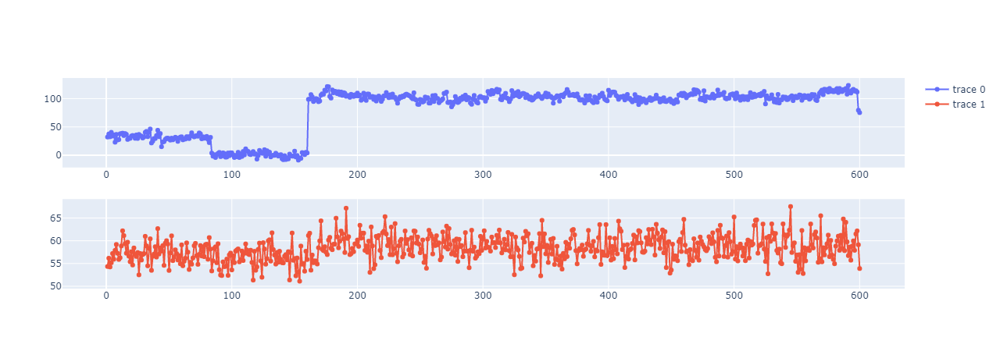

In [5]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=2, cols=1)
trace = go.Scatter(mode='lines+markers', x=dat.Data.y_array, y=mids)
fig.add_trace(trace, row=1, col=1)
trace = go.Scatter(mode='lines+markers', x=dat.Data.y_array, y=thetas)
fig.add_trace(trace, row=2, col=1)
fig